In [124]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
% matplotlib inline

UsageError: Line magic function `%` not found.


In [2]:
df=pd.read_csv('wiki_movie_plots_deduped_cleaned_genre_and_plot.csv')
df

,Release Year,Title,Origin/Ethnicity,Director,Cast,Genre,Genre_updated,Wiki Page,Plot,Plot_cleanned
0,1901,Kansas Saloon Smashers,American,Unknown,NaN,NaN,NaN,https://en.wikipedia.org/wiki/Kansas_Saloon_Sm...,"A bartender is working at a saloon, serving dr...",bartender working saloon serving drink custome...
1,1901,Love by the Light of the Moon,American,Unknown,NaN,NaN,NaN,https://en.wikipedia.org/wiki/Love_by_the_Ligh...,"The moon, painted with a smiling face hangs ov...",moon painted smiling face hang park night youn...
2,1901,The Martyred Presidents,American,Unknown,NaN,NaN,NaN,https://en.wikipedia.org/wiki/The_Martyred_Pre...,"The film, just over a minute long, is composed...",film minute long composed two shot first girl ...
3,1901,"Terrible Teddy, the Grizzly King",American,Unknown,NaN,NaN,NaN,"https://en.wikipedia.org/wiki/Terrible_Teddy,_...",Lasting just 61 seconds and consisting of two ...,lasting second consisting two shot first shot ...
4,1902,Jack and the Beanstalk,American,"George S. Fleming, Edwin S. Porter",NaN,NaN,NaN,https://en.wikipedia.org/wiki/Jack_and_the_Bea...,The earliest known adaptation of the classic f...,earliest known adaptation classic fairytale fi...
...,...,...,...,...,...,...,...,...,...,...
41656,2014,The Water Diviner,Turkish,Director: Russell Crowe,Director: Russell Crowe\r\nCast: Russell Crowe...,NaN,NaN,https://en.wikipedia.org/wiki/The_Water_Diviner,"The film begins in 1919, just after World War ...",film begin wxyz world war ended centre around ...
41657,2017,Çalgı Çengi İkimiz,Turkish,Selçuk Aydemir,"Ahmet Kural, Murat Cemcir",comedy,comedy,https://en.wikipedia.org/wiki/%C3%87alg%C4%B1_...,"Two musicians, Salih and Gürkan, described the...",two musician salih gürkan described adventure ...
41658,2017,Olanlar Oldu,Turkish,Hakan Algül,"Ata Demirer, Tuvana Türkay, Ülkü Duru",comedy,comedy,https://en.wikipedia.org/wiki/Olanlar_Oldu,"Zafer, a sailor living with his mother Döndü i...",zafer sailor living mother döndü coastal villa...
41659,2017,Non-Transferable,Turkish,Brendan Bradley,"YouTubers Shanna Malcolm, Shira Lazar, Sara Fl...",romantic comedy,comedy,https://en.wikipedia.org/wiki/Non-Transferable...,The film centres around a young woman named Am...,film centre around young woman named amy tyler...


In [8]:
from collections import Counter


In [19]:
Counter(" ".join(df[df['Genre_updated']=='romance']['Plot_cleanned']).split()).most_common(500)

[('love', 3718),
 ('get', 2302),
 ('father', 2026),
 ('go', 1884),
 ('friend', 1853),
 ('life', 1719),
 ('tell', 1718),
 ('find', 1620),
 ('one', 1598),
 ('meet', 1582),
 ('family', 1499),
 ('day', 1496),
 ('take', 1443),
 ('come', 1439),
 ('time', 1250),
 ('back', 1221),
 ('mother', 1154),
 ('fall', 1103),
 ('also', 1096),
 ('two', 1072),
 ('see', 1064),
 ('make', 1047),
 ('girl', 1021),
 ('later', 1002),
 ('home', 991),
 ('marriage', 965),
 ('house', 950),
 ('try', 947),
 ('story', 920),
 ('married', 907),
 ('man', 883),
 ('return', 880),
 ('however', 868),
 ('son', 852),
 ('’', 836),
 ('want', 835),
 ('start', 832),
 ('year', 829),
 ('marry', 828),
 ('daughter', 825),
 ('end', 822),
 ('film', 782),
 ('help', 779),
 ('asks', 766),
 ('decides', 749),
 ('new', 743),
 ('know', 741),
 ('away', 738),
 ('raj', 713),
 ('give', 693),
 ('parent', 692),
 ('leaf', 672),
 ('relationship', 665),
 ('woman', 653),
 ('money', 645),
 ('work', 642),
 ('police', 642),
 ('brother', 633),
 ('wife', 632),

In [33]:
choices_final=df['Genre_updated'].unique()[1:]
choices_final

array(['western', 'comedy', 'action', 'crime', 'biography', 'drama',
       'adventure', 'fantasy', 'horror', 'historical', 'documentary',
       'serial', 'mystery', 'romance', 'war', 'animated', 'family',
       'thriller', 'musical', 'science fiction', 'noir', 'sci-fi',
       'martial_arts', 'social', 'anime'], dtype=object)

In [66]:
%%time
dax={choices:Counter(" ".join(df[df['Genre_updated']==choices]['Plot_cleanned']).split()).most_common(5   00) for choices in choices_final}

Wall time: 2.64 s


In [114]:
data=pd.DataFrame(columns = ['Genre', 'Words', 'Counts'])
for i in dax.keys():
    df=pd.concat([pd.DataFrame([i for j in range(len(dax[i]))],columns=['Genre']),pd.DataFrame(dax[i],columns=['Words', 'Counts'])],axis=1)
    data=pd.concat([data,df])

In [115]:
data

,Genre,Words,Counts
0,western,town,1144
1,western,men,940
2,western,take,683
3,western,back,672
4,western,one,671
...,...,...,...
495,anime,nearly,18
496,anime,accidentally,18
497,anime,feeling,18
498,anime,cry,18


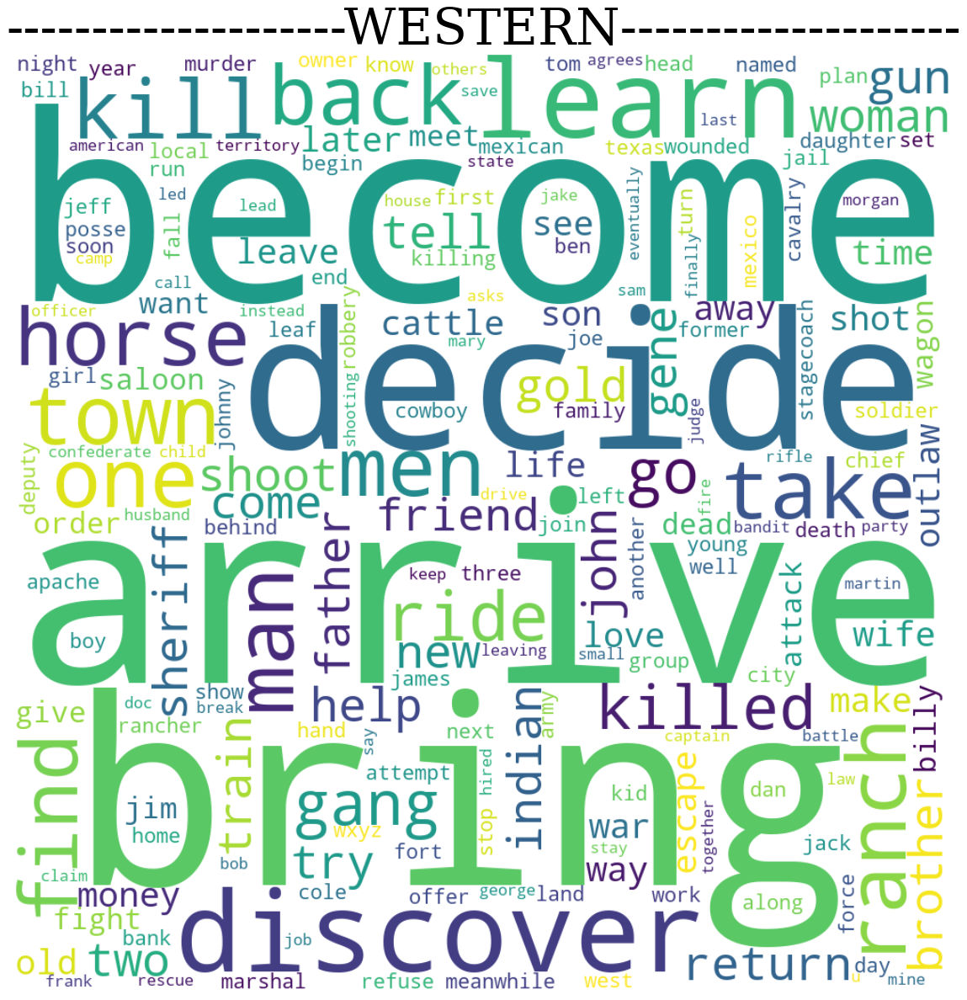

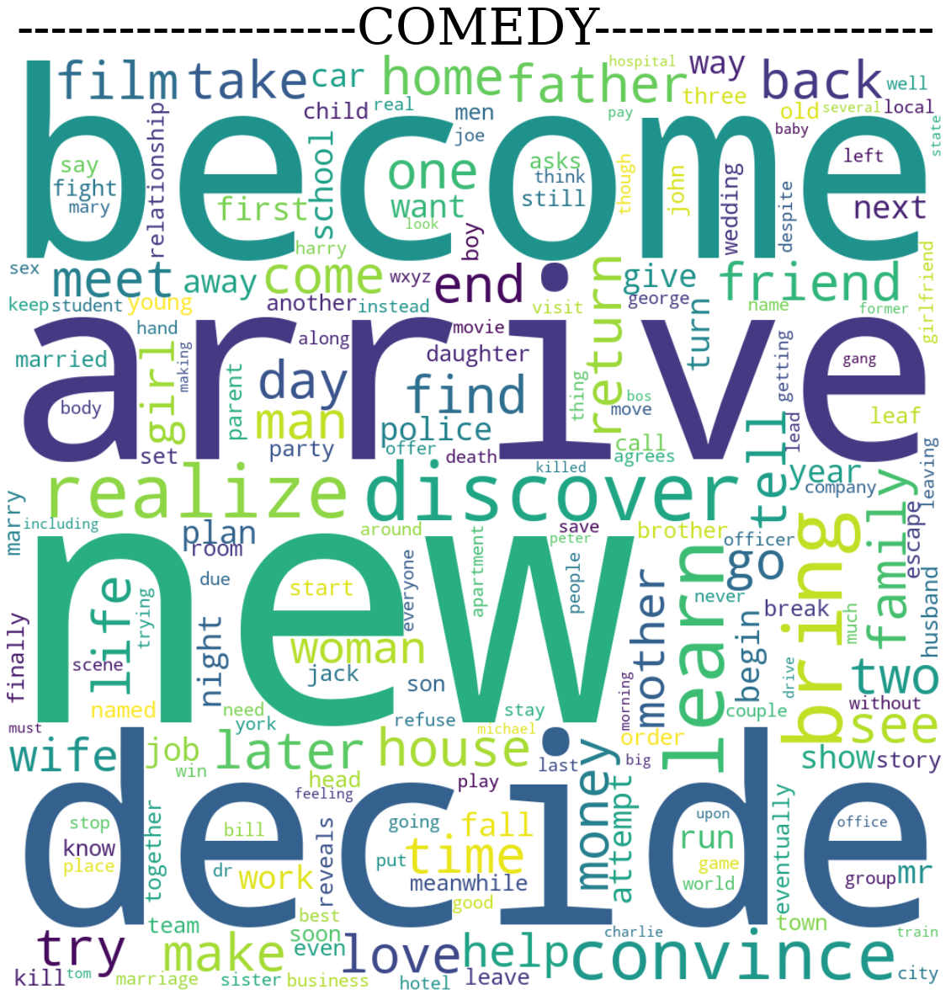

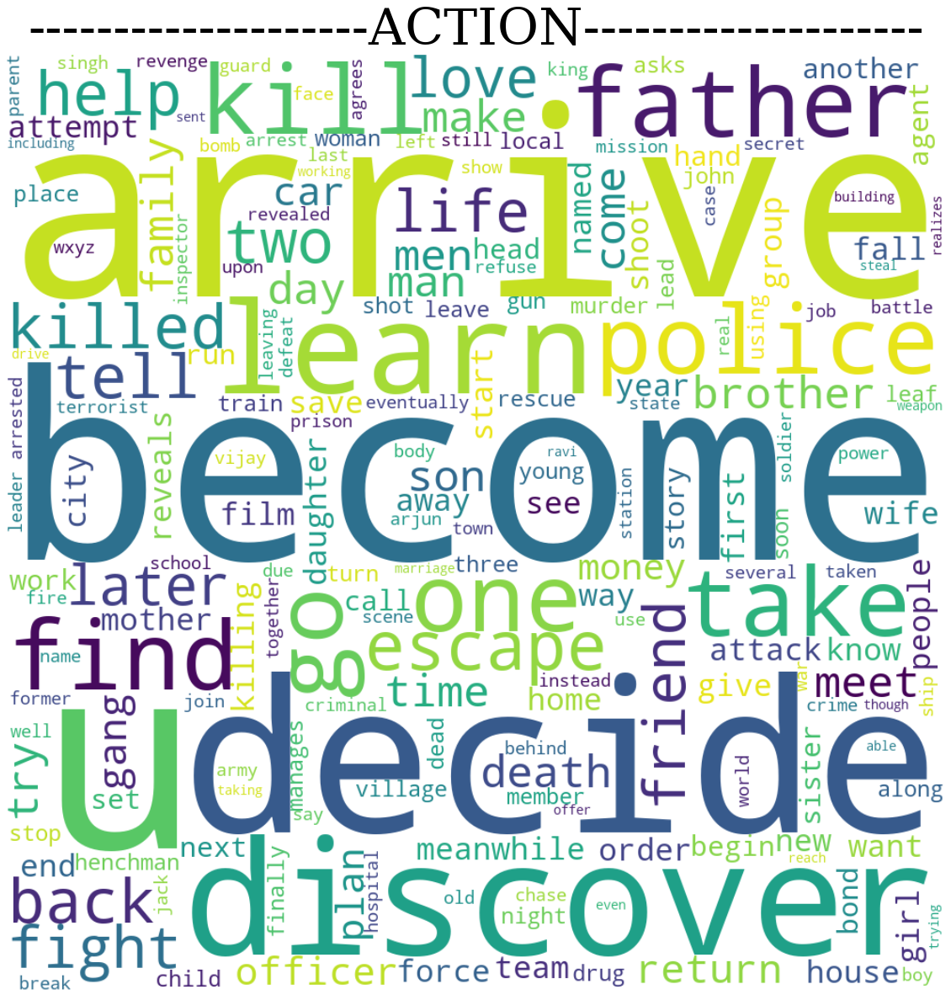

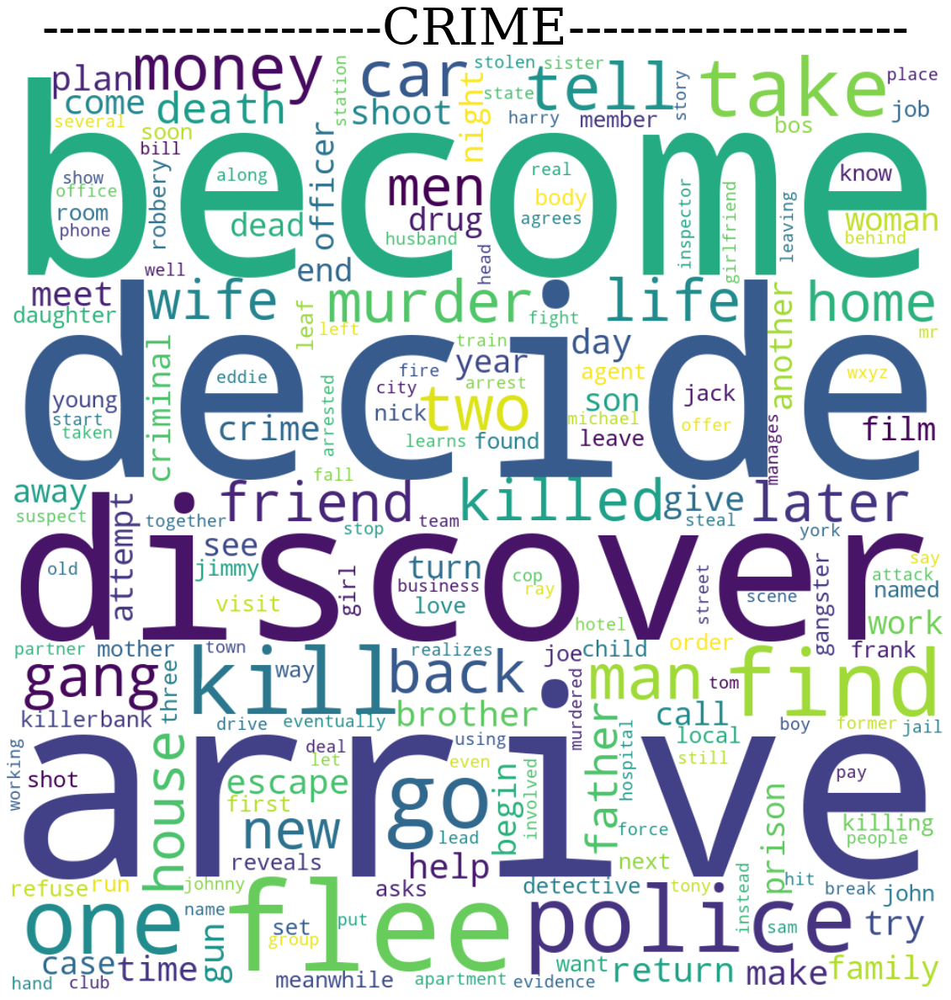

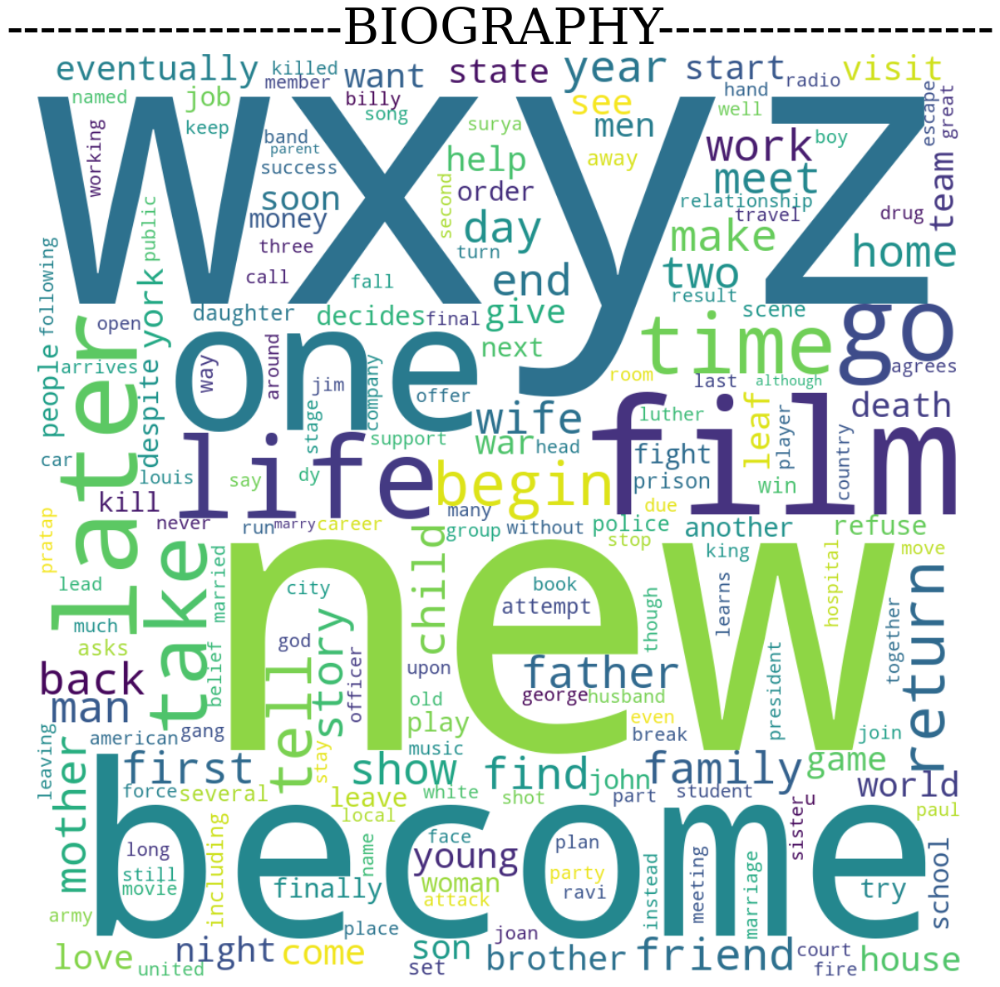

...

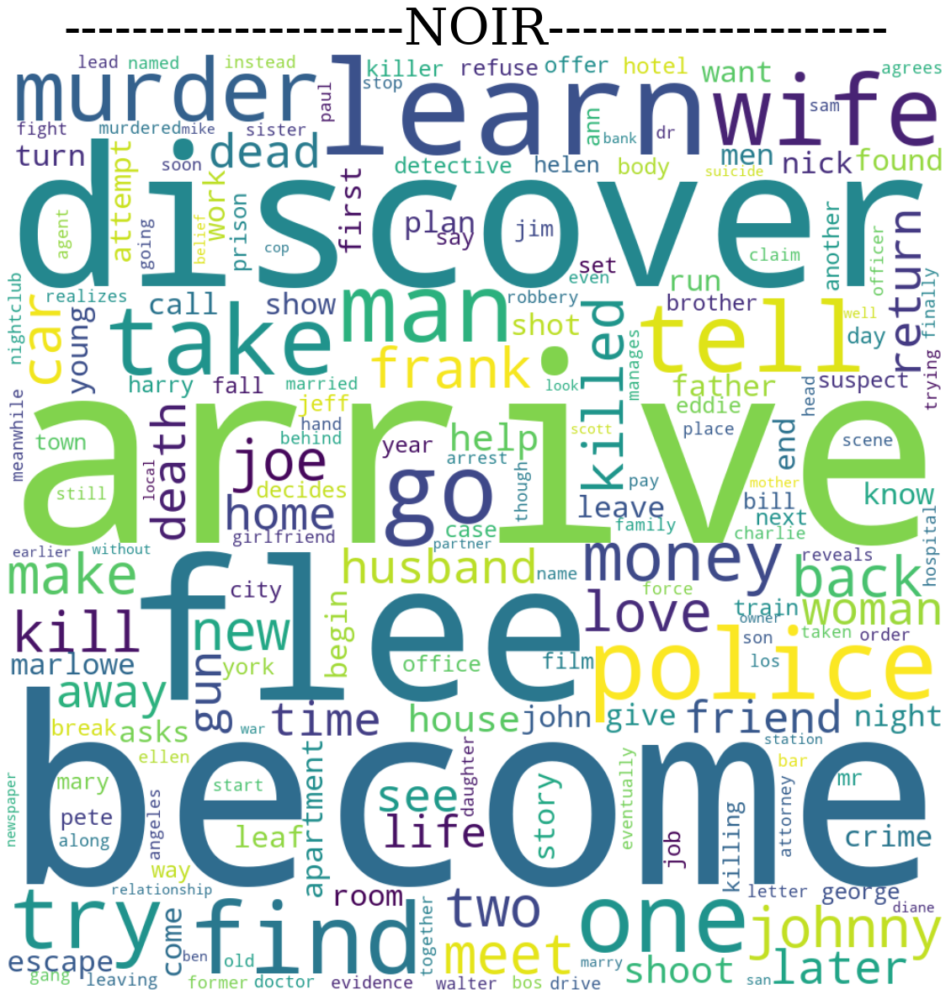

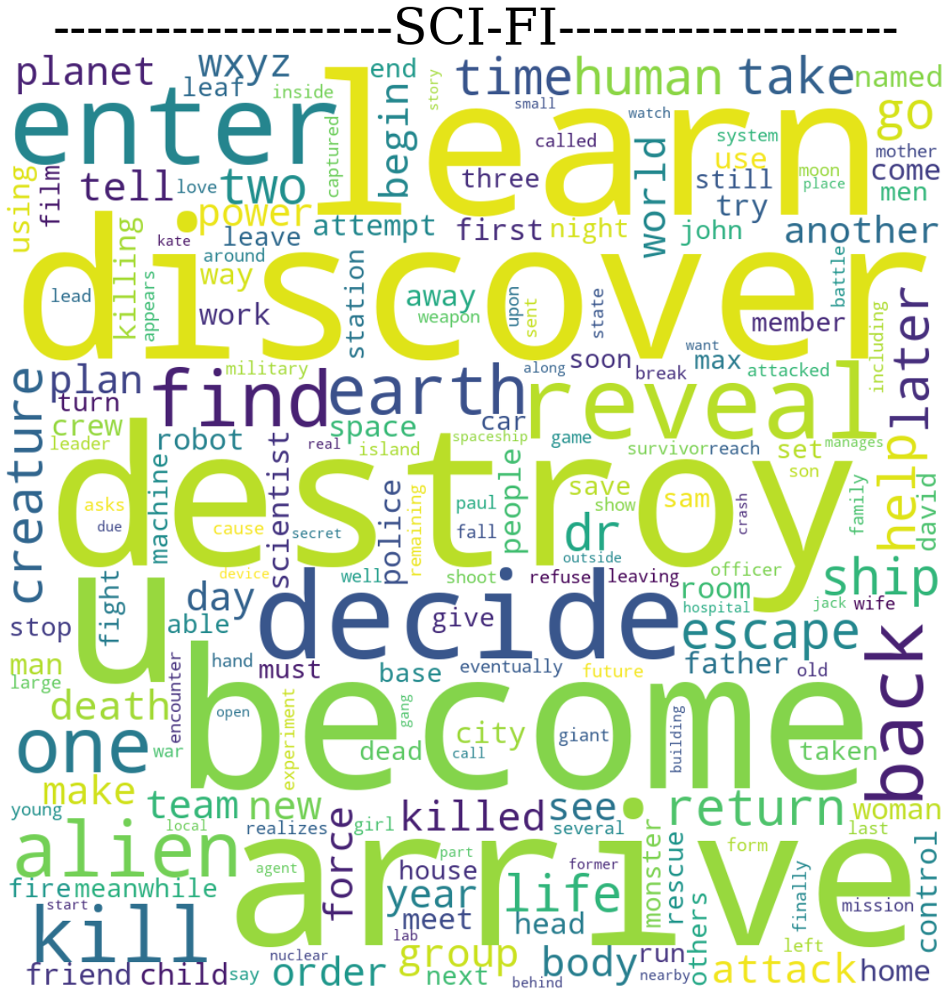

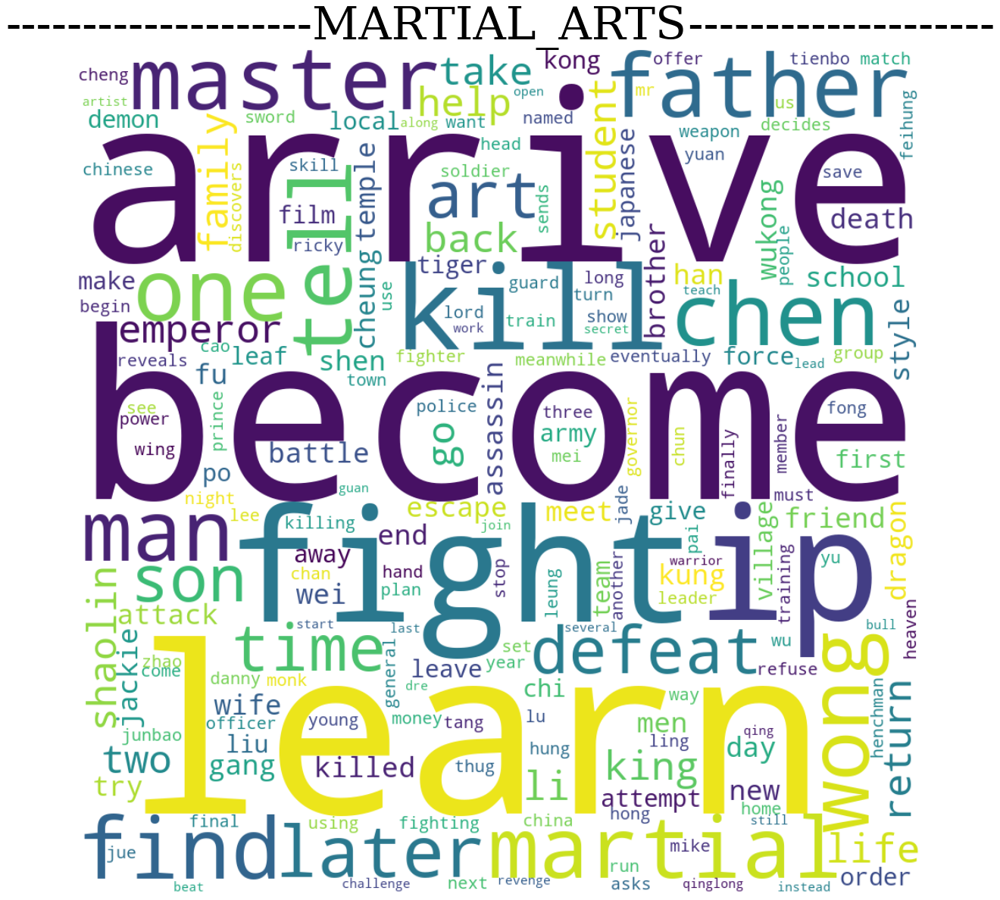

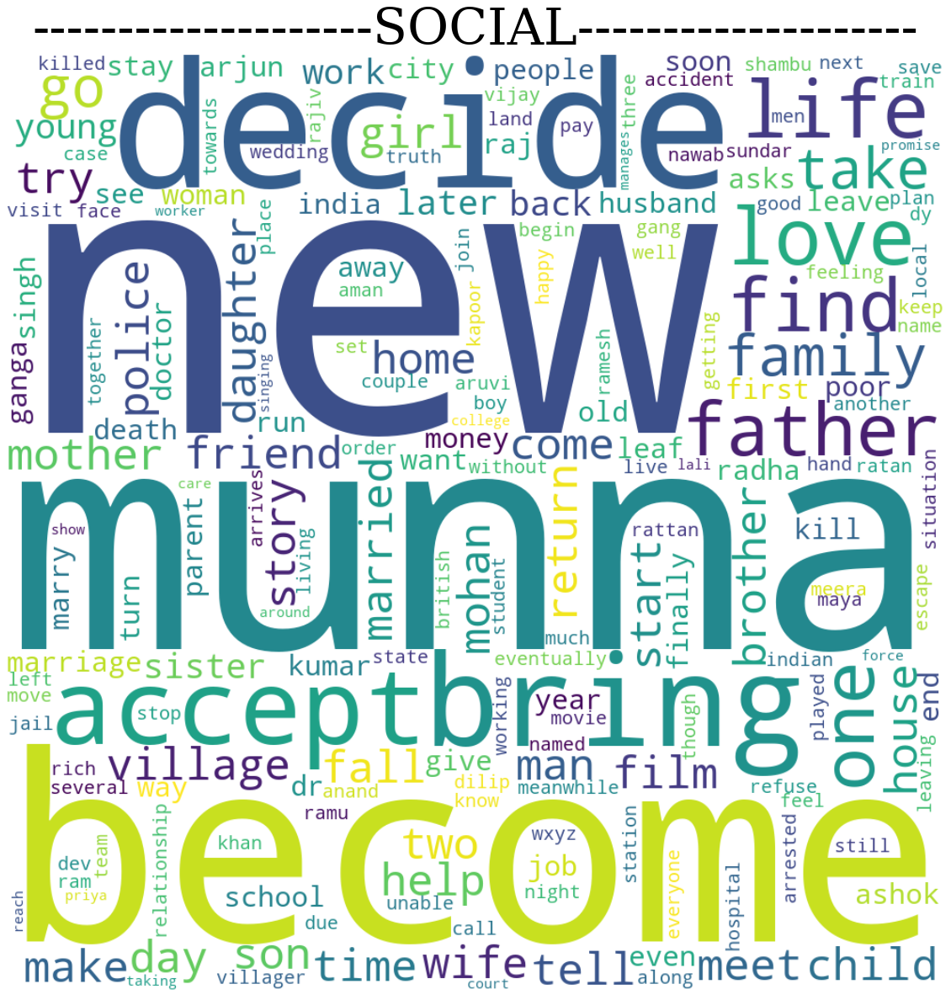

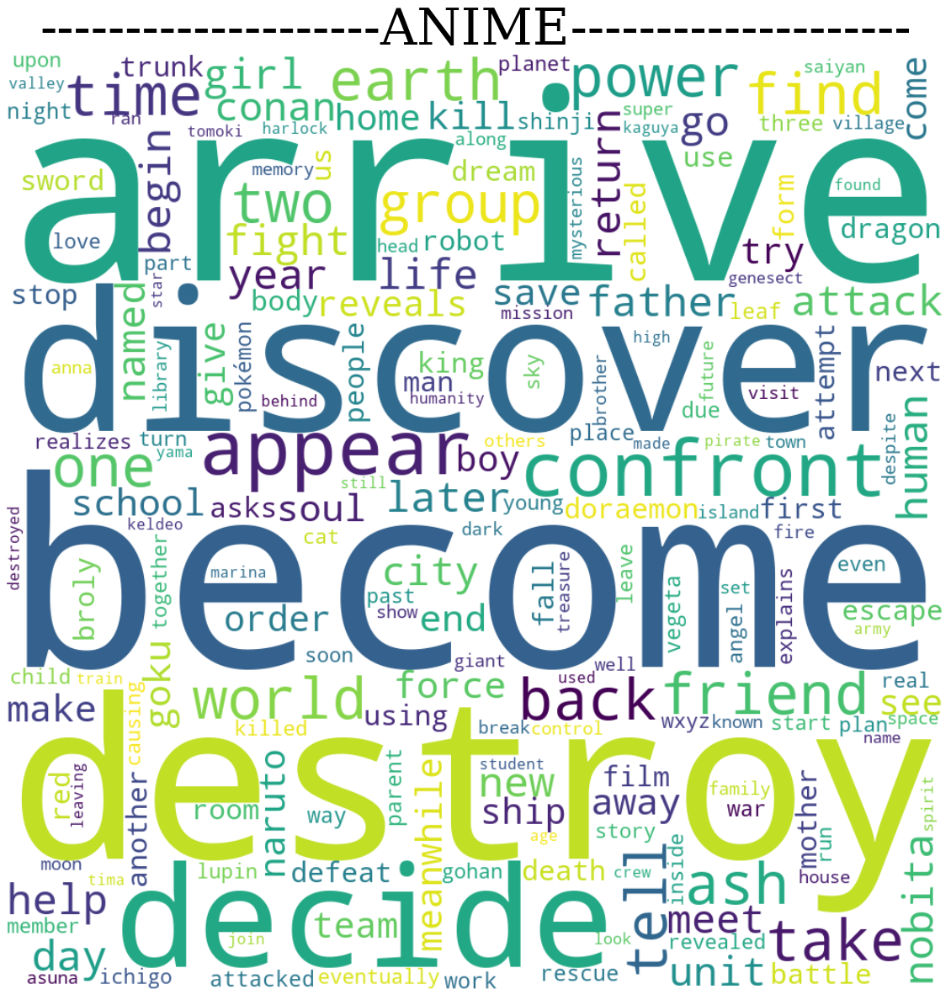

In [148]:
font = {'family': 'serif',
            'weight': 'normal',
            'size': 60,
            }

for i in choices_final:
    
    word_cloud = WordCloud(width = 1000, height = 1000,background_color ='white').generate(" ".join(title for title in data[data['Genre']==i]['Words']))
    plt.figure(figsize = (20, 35), facecolor = None)
    plt.imshow(word_cloud, interpolation='bilinear')
    plt.axis("off")
    plt.title('-'*20+i.upper()+'-'*20,fontdict=font)
    plt.show()
    print('\n')